# <h1><center><font color=darkgreen> P181 - Reliance Industries Stock Forecast (Group 4)</font></center></h1>

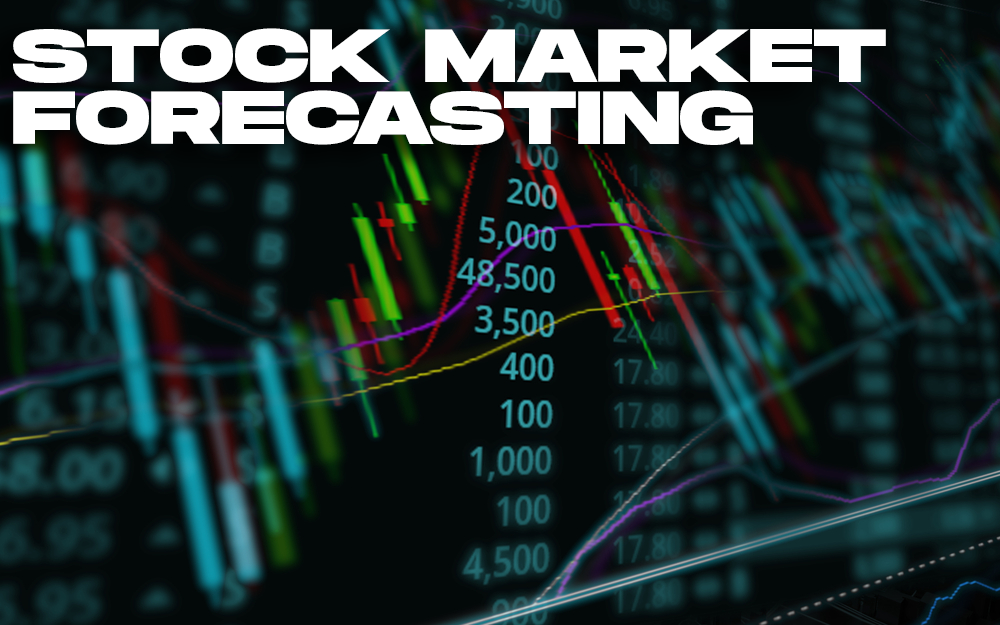

## <h1><center><font color=darkblue>Business Objective</font></center></h1>


Predict the Industries Stock Price for the next 30 days.<br>
There are Open, High, Low and Close prices that you need to obtain from the web for each day starting from 2015 to 2022 for Industries stock.<br>
1) Split the last year into a test set- to build a model to predict stock price.<br>
2) Find short term, & long term trends.<br>
3) Understand how it is impacted from external factors or any big external events.
   Forecast for next 30 days.<br>


# <h1><center><font color=darkblue>About DataSet</font></center></h1>

Adjusted close is the closing price after adjustments for all applicable splits and dividend distributions. Data is adjusted using appropriate split and dividend multipliers, adhering to Center for Research in Security Prices (CRSP) standards

# Lifecycle in a Data Science Project
* Data Analysis
* Feature Engineering
* Feature Extraction
* Model Building
* Model Deployment

## <h1><center><font color=darkblue>Importing Libraries</font></center></h1>

In [14]:
import numpy as np 
import pandas as pd
import seaborn as sns
from datetime import datetime
import matplotlib.pyplot as plt
import matplotlib.dates as mdates
import matplotlib as npl
import datetime as dt
import yfinance as yf
from statsmodels.tsa.seasonal import seasonal_decompose
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
import cufflinks as cf
import plotly.graph_objects as go
import plotly.express as px
from plotly.offline import iplot, init_notebook_mode
from statsmodels.tsa.arima.model import ARIMA
from math import sqrt
from sklearn.metrics import mean_squared_error
from dataprep.eda import plot, plot_correlation, plot_missing, create_report

In [2]:
# Supressing warnings
import warnings
warnings.filterwarnings('ignore')
sns.set_style('whitegrid')
%matplotlib inline
npl.rcParams['figure.figsize']=(16,8)
npl.rcParams['axes.grid']=False

### In Time Series Analysis we will analyze to find out the below stuff

* Missing values
* Duplicated values
* Outlier Detection
* Feature Scaling
* Feature Extraction
* Correlation
* Skewness Removal
* Data Insights
* Stationarity Test
* Autocorrelation Function
* Partial Autocorrelation Function
* Lag plots
* Normal Distribution Analysis
* Relationshop between independent and dependent feature 

## <h1><center><font color=darkblue>Importing Datasets</font></center></h1>

In [3]:
reliance = yf.download('RELIANCE.NS',start = '2015-1-1').round(4)
reliance1 = reliance.copy() #duplicating dataset for visualisation purpose
reliance

[*********************100%***********************]  1 of 1 completed


,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,
2015-01-01,438.9888,441.8121,437.6763,439.7813,417.9889,1367720
2015-01-02,439.8804,443.8181,437.9982,438.6173,416.8826,3383424
2015-01-05,438.3449,441.2672,432.9461,433.8129,412.3163,4662967
2015-01-06,430.9153,432.4013,412.0938,414.1245,393.6035,8596809
2015-01-07,414.6198,425.3680,414.5703,423.1391,402.1713,9562421
...,...,...,...,...,...,...
2023-01-20,2475.0000,2475.0000,2437.2500,2442.6499,2442.6499,6890325
2023-01-23,2449.0000,2466.2000,2425.0000,2430.3000,2430.3000,5055324
2023-01-24,2440.0000,2443.6499,2387.3501,2415.9500,2415.9500,7609558


Note:

Adjusted close is the closing price after adjustments for all applicable splits and dividend distributions. 

Inference :

1) Importing data using Yfinance library which updates regularly. <br>


## <h1><center><font color=darkblue>Exploratory Data Analysis (EDA)</font></center></h1>

In [4]:
reliance.shape

(1995, 6)

In [5]:
reliance.info()

<class 'pandas.core.frame.DataFrame'>
DatetimeIndex: 1995 entries, 2015-01-01 to 2023-01-27
Data columns (total 6 columns):
 #   Column     Non-Null Count  Dtype  
---  ------     --------------  -----  
 0   Open       1995 non-null   float64
 1   High       1995 non-null   float64
 2   Low        1995 non-null   float64
 3   Close      1995 non-null   float64
 4   Adj Close  1995 non-null   float64
 5   Volume     1995 non-null   int64  
dtypes: float64(5), int64(1)
memory usage: 109.1 KB


In [6]:
reliance.describe()

,Open,High,Low,Close,Adj Close,Volume
count,1995.000000,1995.000000,1995.000000,1995.000000,1995.000000,1.995000e+03
mean,1327.053169,1342.026087,1311.298095,1326.026597,1311.723297,9.058058e+06
std,757.377278,765.509196,748.485894,756.613331,760.941999,6.672449e+06
min,404.466100,405.010900,394.485700,401.568500,381.669700,7.871600e+05
25%,532.254750,539.151850,528.193250,532.898650,517.516000,5.238144e+06
50%,1185.809700,1203.591200,1168.919800,1184.472400,1169.244900,7.126582e+06
75%,2066.550050,2089.949950,2035.125000,2060.250000,2048.528050,1.021913e+07
max,2856.149900,2856.149900,2786.100100,2819.850100,2811.385700,6.584835e+07


In [7]:
reliance.isnull().sum()

Open         0
High         0
Low          0
Close        0
Adj Close    0
Volume       0
dtype: int64

In [8]:
reliance[reliance.duplicated()]

,Open,High,Low,Close,Adj Close,Volume
Date,,,,,,


In [9]:
#calculating monthly , daily returns and cumulative returns of reliance for visuallisation
Reliance_daily_returns = reliance['Adj Close'].pct_change()
Reliance_monthly_returns = reliance['Adj Close'].resample('M').ffill().pct_change()
Reliance_cum_returns = (Reliance_daily_returns + 1).cumprod()

In [10]:
#calculating cumulative returns of Mulitiple stocks for visuallisation
tickers = ["HDFCBANK.NS","TCS.NS","HINDUNILVR.NS",'RELIANCE.NS']
multpl_stocks = yf.download(tickers,start = "2015-01-01")

multpl_stock_daily_returns = multpl_stocks['Adj Close'].pct_change()
multpl_stock_monthly_returns = multpl_stocks['Adj Close'].resample('M').ffill().pct_change()

[*********************100%***********************]  4 of 4 completed


Note:

1) Daily returns: Daily return on a stock is used to measure the day to day performance of stocks, it is the price of stocks at today’s closure compared to the price of the same stock at yesterday’s closure. <br>

2) Monthly returns: Monthly Return is the period returns re-scaled to a period of 1 month. <br>

3) Cumulative returns: A cumulative return on an investment is the aggregate amount that the investment has gained or lost over time, independent of the amount of time involved.<br>
    

In [11]:
#resetting index
reliance=reliance.reset_index()
reliance

,Date,Open,High,Low,Close,Adj Close,Volume
0,2015-01-01,438.9888,441.8121,437.6763,439.7813,417.9889,1367720
1,2015-01-02,439.8804,443.8181,437.9982,438.6173,416.8826,3383424
2,2015-01-05,438.3449,441.2672,432.9461,433.8129,412.3163,4662967
3,2015-01-06,430.9153,432.4013,412.0938,414.1245,393.6035,8596809
4,2015-01-07,414.6198,425.3680,414.5703,423.1391,402.1713,9562421
...,...,...,...,...,...,...,...
1990,2023-01-20,2475.0000,2475.0000,2437.2500,2442.6499,2442.6499,6890325
1991,2023-01-23,2449.0000,2466.2000,2425.0000,2430.3000,2430.3000,5055324
1992,2023-01-24,2440.0000,2443.6499,2387.3501,2415.9500,2415.9500,7609558
1993,2023-01-25,2412.4500,2414.7000,2380.0000,2382.5500,2382.5500,5715684


In [15]:
#Adjusting Date format and separating month and year columns
reliance['Date'] = pd.to_datetime(reliance['Date'], format='%Y-%m-%d')
reliance["Month"]= reliance.Date.dt.strftime("%b")
reliance["Year"]= reliance.Date.dt.strftime("%Y")

  0%|                                                                                         | 0/1391 [00:00<…

DataPrep Report
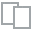
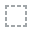
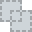
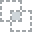
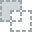
...
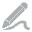
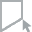
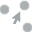
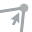
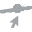

In [16]:
create_report(reliance)

## <h1><center><font color=darkblue>Data Visualizations</font><br></center></h1>

### Closing Price
The closing price is the last price at which the stock is traded during the regular trading day. A stock’s closing price is the standard benchmark used by investors to track its performance over time.

### <font color=seagreen>1. Line Chart </font>

In [17]:
fig = px.line(reliance, x='Date', y='Close',title= 'Line chart on Closing Price')
fig.update_xaxes(rangeslider_visible=True,color="black")
fig.update_traces(line_color='green')
fig.show()

Inference :

1) We can see that the in the long term stock is in upward exponentital trend with no seasonality  since 2015. <br>
2) Whereas, in the recent short term we can see that the stock is stuck in a range and is in a constant trend. <br>

### <font color=seagreen>2. Distribution plots </font>

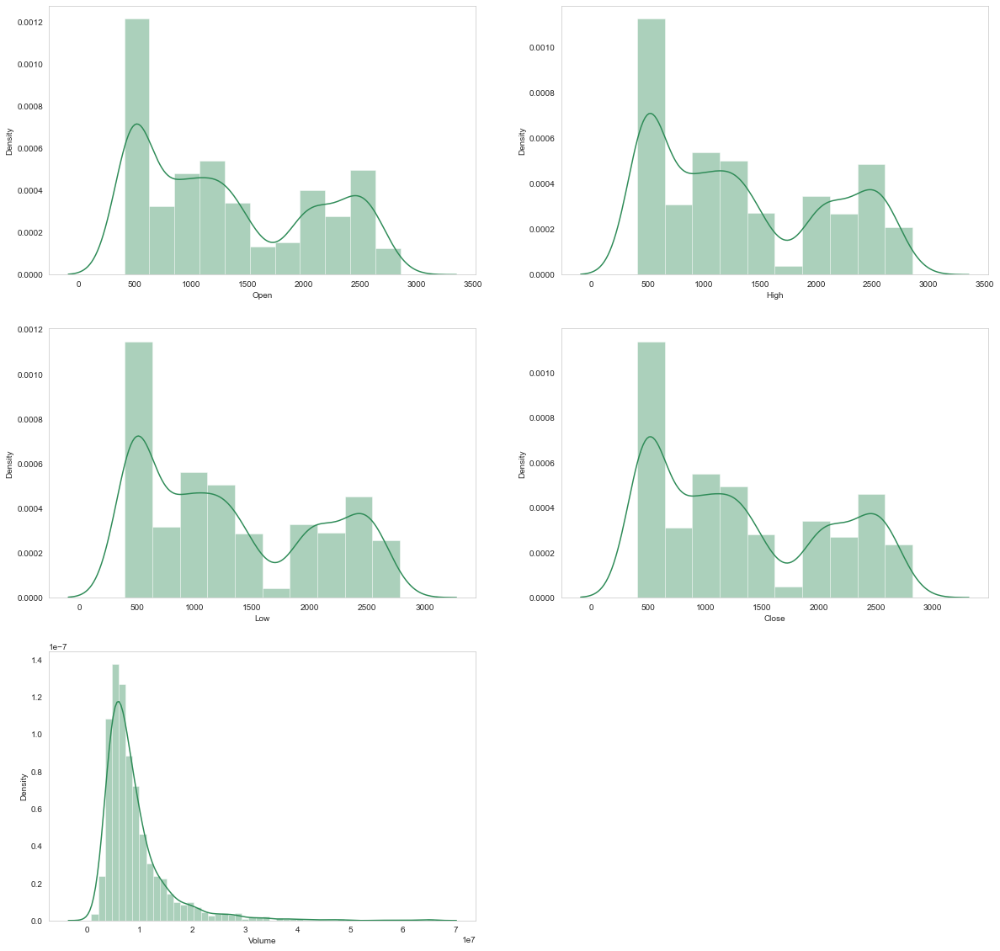

In [18]:
#Distribution plots of Open, High, Low, Close,and Volume.
features = ['Open', 'High', 'Low', 'Close', 'Volume']
plt.subplots(figsize=(20,20))

for i, col in enumerate(features):
  plt.subplot(3,2,i+1)
  sns.distplot(reliance[col],color ="seagreen" )
plt.show()

Inference:
    
1) In the distribution plot of OHLC data, we can see  Volume data is right-skewed, and other features show a double peak distribution or bimodal distribution. <br>

### <font color=seagreen>3. Candlestick Chart </font>

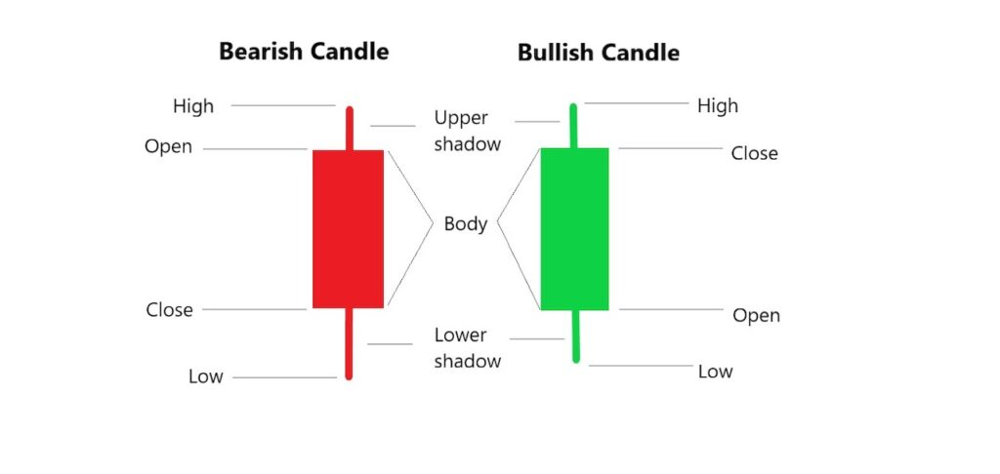

Note: 

1) A green candlestick means that the opening price on that day was lower than the closing price that day.<br>
2) A red candlestick is a price chart indicating that the closing price of a security is below both the price at which it opened and previously closed. <br>

In [19]:
cf.go_offline()
init_notebook_mode()

#Candlestick chart of reliance stock
qf = cf.QuantFig(reliance1, title="Reliance's stock price since 2015 with Volumea and Moving average ",legend='top',up_color='green', down_color='red', name='RELIANCE.NS')
qf.add_volume(name='Volume',up_color='green', down_color='red')
qf.add_sma(periods=50, column=None, str=None,color='red')
qf.add_sma(periods=100, column=None, str=None,color='violet')
qf.add_sma(periods=200, column=None, str=None,color='blue')
qf.add_sma(periods=400, column=None, str=None,color='orange')
qf.iplot()

Note:

1) Volume in the stock market means the total number of shares traded in a specified time frame. This would include every share that is bought and sold during the time period in review. <br>

2) SMA is the easiest moving average to construct. It is simply the average price over the specified period. 

Inference :

1) Above graph shows candlestick pattern of the stock. <br>
2) Each candle represents the open, close, high, and low of the particular day,month or week.<br>
3) Bar chart at the bottom of the graph represents volume of the stock traded on the particular day.<br>

### <font color=seagreen>4. Boxplots </font>

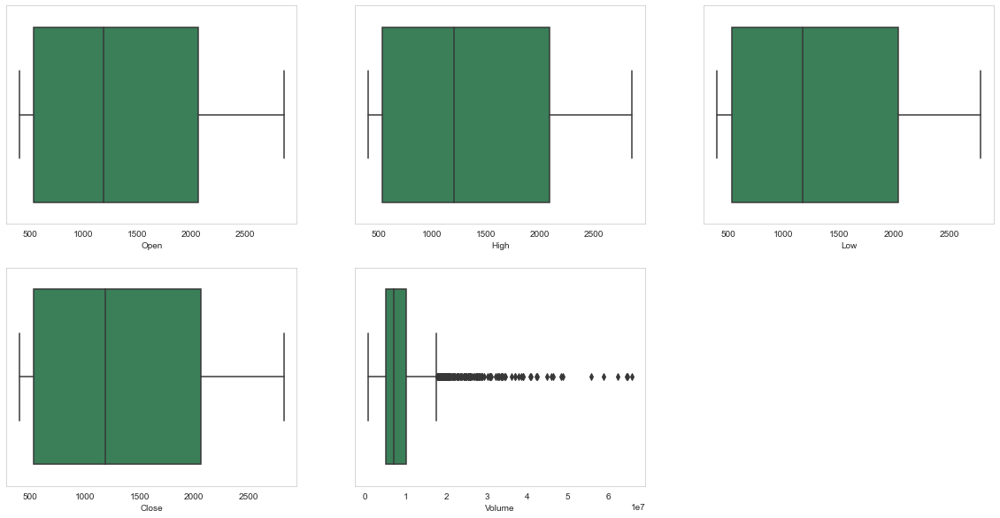

In [20]:
plt.subplots(figsize=(20,10))
for i, col in enumerate(features):
  plt.subplot(2,3,i+1)
  sns.boxplot(reliance[col],color="seagreen")
plt.show()

Inference :

1) From the above boxplots, we can conclude that only volume data contains outliers in it but the data in the rest of the columns are free from any outlier.<br>

### <font color=seagreen>5. Daily, Monthly and Cumulative returns </font>

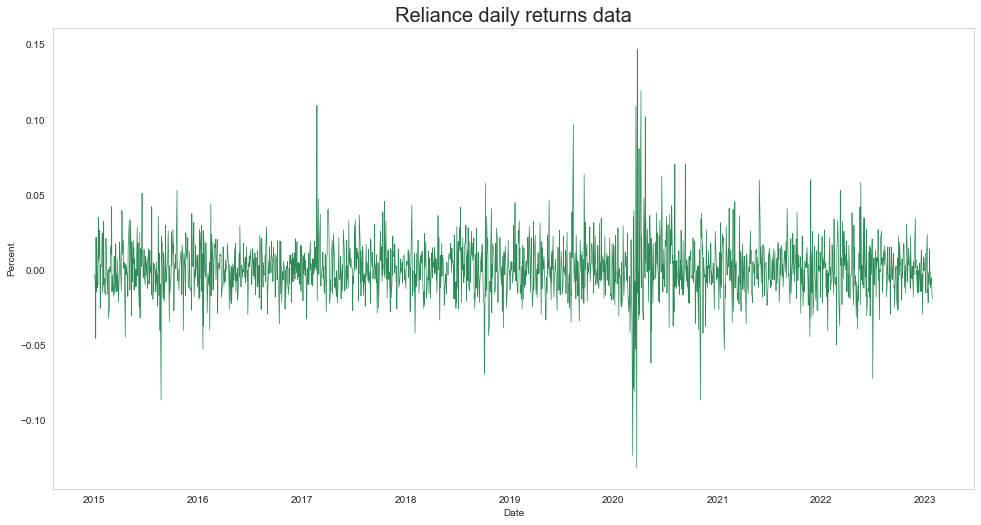

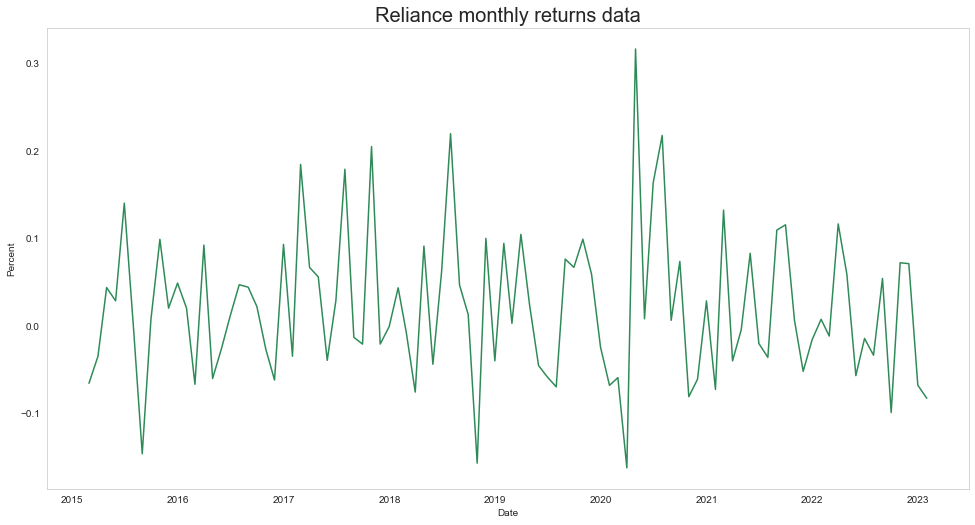

In [21]:
fig = plt.figure()
ax1 = fig.add_axes([0.1,0.1,0.8,0.8])
ax1.plot(Reliance_daily_returns,color="seagreen",linewidth=.7)
ax1.set_xlabel("Date")
ax1.set_ylabel("Percent")
ax1.set_title("Reliance daily returns data",fontsize= 20)
plt.show()

fig = plt.figure()
ax1 = fig.add_axes([0.1,0.1,0.8,0.8])
ax1.plot(Reliance_monthly_returns,color="seagreen")
ax1.set_xlabel("Date")
ax1.set_ylabel("Percent")
ax1.set_title("Reliance monthly returns data",fontsize= 20)
plt.show()

Inference:
    
1) After looking at the daily returns chart for Reliance we can conclude that the returns are quite volatile and the stock can move +/- 15% on any given day. <br>
2) The monthly returns are not quite volatile and can range between -10 to +30%. <br>



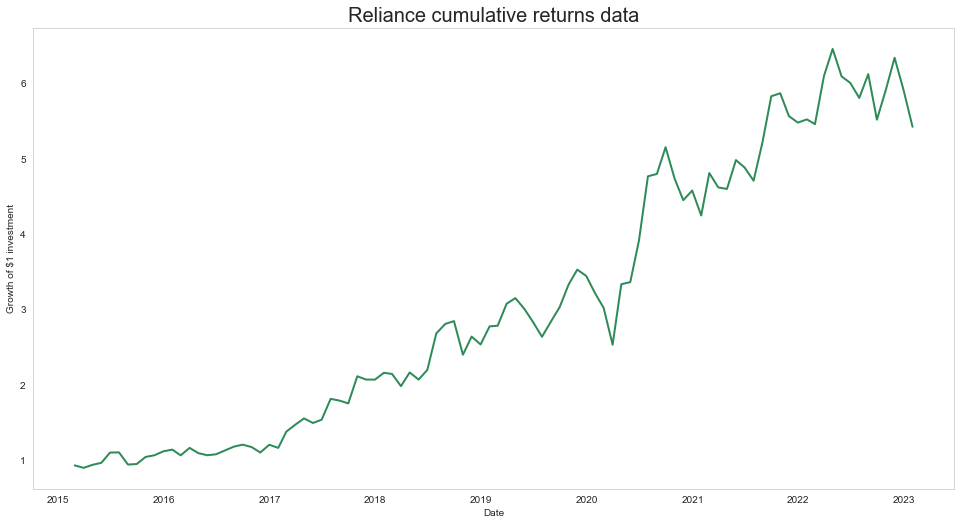

In [22]:
fig = plt.figure()
ax1 = fig.add_axes([0.1,0.1,0.8,0.8])
netflix_cum_returns = (Reliance_monthly_returns + 1).cumprod()
ax1.plot(netflix_cum_returns,color= 'seagreen',linewidth=2.0)
ax1.set_xlabel("Date")
ax1.set_ylabel("Growth of $1 investment")
ax1.set_title("Reliance cumulative returns data",fontsize= 20)
plt.show()

Inference:

1) This chart shows the cumulative returns since 2015 for Reliance. With the power of hindsight, one could have made more than  \\$6 on a \\$1 investment since 2015 which is 600% of the initial investment<br>

<Figure size 1152x576 with 0 Axes>

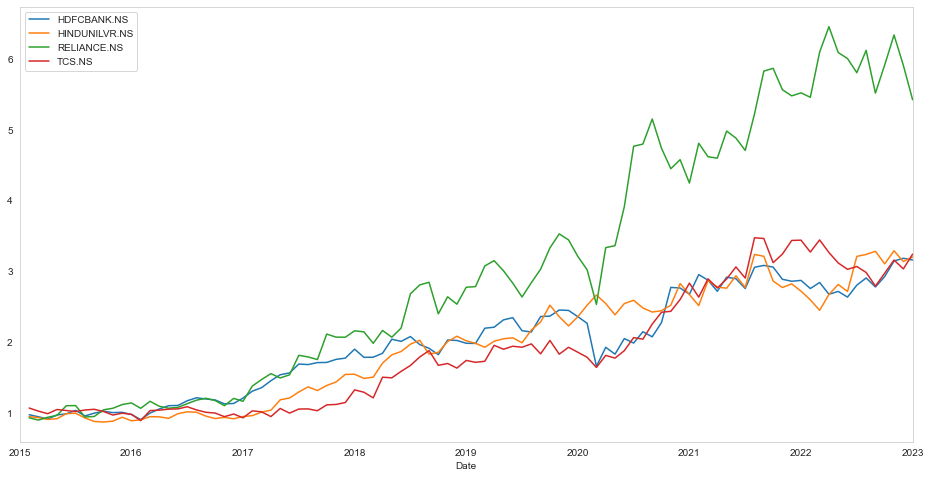

In [23]:
fig = plt.figure()
(multpl_stock_monthly_returns + 1).cumprod().plot(linewidth=1.5)
plt.show()

Inference:
    
1) Comparing the Cumulative returns of reliance to other stocks like HDFC bank and TCS.Not surprisingly, Reliance had the best returns since 2015. HUL and HDFC Bank come in distant second and third.

## <h1><center><font color=darkblue>Model Building</font><br></center></h1>

#### <h1><center><font color=darkblue>Short Term Forecasting</font><br></center></h1>

In [24]:
# Making the Date as DateTime index for the Dataframe.
reliance.set_index('Date',inplace=True)
# Droping columns
reliance = reliance.drop(['Open','High','Low','Adj Close','Volume','Month','Year'], axis=1)
reliance2 = reliance.copy()
# Resampling day wise
upsampled_day = reliance.resample('D').mean()
upsampled_day.head()

,Close
Date,
2015-01-01,439.7813
2015-01-02,438.6173
2015-01-03,NaN
2015-01-04,NaN
2015-01-05,433.8129


                 Close
Date                  
2015-01-01  439.781300
2015-01-02  438.617300
2015-01-03  437.015833
2015-01-04  435.414367
2015-01-05  433.812900
2015-01-06  414.124500
2015-01-07  423.139100
2015-01-08  417.071600
2015-01-09  426.110900
2015-01-10  424.459867


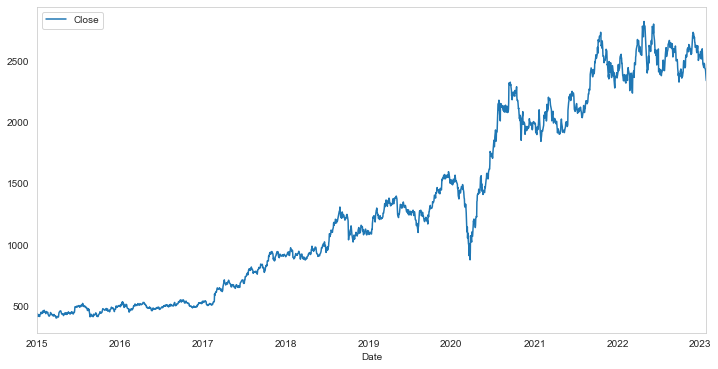

In [25]:
# Interpolation was done for nan values which we get after doing upsampling by day
reliance_day = upsampled_day.interpolate(method='linear')
print(reliance_day.head(10))
reliance_day.plot(figsize=(12,6))
plt.show()

Inference:

<br>
Interpolating data as we have missing values due to weekends and stock market holidays.

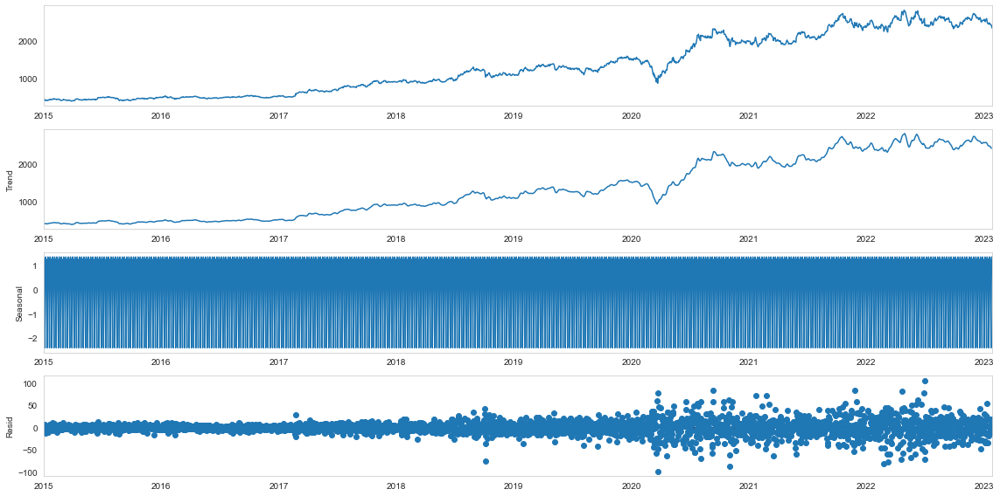

In [26]:
decompose_add = seasonal_decompose(reliance_day)
decompose_add.plot();

Inference:-<br>
1) Decomposition plot shows trend and seasonality.
    

In [27]:
# splitting data set in train and test (80% : 20%)
train_set, test_set= np.split(reliance_day, [int(.80 *len(reliance_day))])

### <font color=darkgreen>1. Single Exponential Smoothing</font><br>

Single Exponential Smoothing, SES for short, also called Simple Exponential Smoothing, is a time series forecasting method for univariate data without a trend or seasonality.

In [28]:
from statsmodels.tsa.holtwinters import SimpleExpSmoothing, ExponentialSmoothing
from sklearn.metrics import mean_squared_error, mean_absolute_percentage_error

single_exp = SimpleExpSmoothing(train_set["Close"]).fit()
pred_single_exp = single_exp.predict(start = test_set.index[0],end = test_set.index[-1])
MAPE_single_exp = mean_absolute_percentage_error(pred_single_exp,test_set.Close)
MAPE_single_exp

0.12413895681746927

### <font color=darkgreen>2. Double Exponential Smoothing</font><br>

Double Exponential Smoothing is an extension to Exponential Smoothing that explicitly adds support for trends in the univariate time series

In [29]:
double_exp = ExponentialSmoothing(train_set["Close"], trend=None, seasonal='add').fit()
pred_double_exp = double_exp.predict(start = test_set.index[0],end = test_set.index[-1])
MAPE_double_exp = mean_absolute_percentage_error(pred_double_exp,test_set.Close)
MAPE_double_exp

0.12459057584708584

### <font color=darkgreen>3. Triple Exponential Smoothing</font><br>

Triple Exponential Smoothing is an extension of Exponential Smoothing that explicitly adds support for seasonality to the univariate time series. Also known as Holt-Winters Exponential Smoothing.

In [30]:
triple_exp = ExponentialSmoothing(train_set["Close"], trend = 'add', seasonal = "add", seasonal_periods=10).fit()
pred_triple_exp = triple_exp.predict(start = test_set.index[0],end = test_set.index[-1])
MAPE_triple_exp = mean_absolute_percentage_error(pred_triple_exp,test_set.Close)
MAPE_triple_exp

0.05556443312592201

### <font color=darkgreen>4. ARIMA</font><br>

NOTE:-<br>
Checking Whether Time-Series is Stationary or Not.<br>
Dicky-Fuller Test for Stationarity.(Once we have removed trend and seasonality from time-series data then we can test its stationarity using a dicky-fuller test. It's a statistical test to check the stationarity of time-series data.)

In [31]:
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller

def stationarity(col):
    res = adfuller(col.dropna())
    print("Test Statistic:", res[0])
    print("P-Value:", res[1])
    if res[1] < 0.05:
        print("Stationary")
    else:
        print("Non-Stationary")

Test Statistic: -0.710705078789224
P-Value: 0.8439571610430101
Non-Stationary


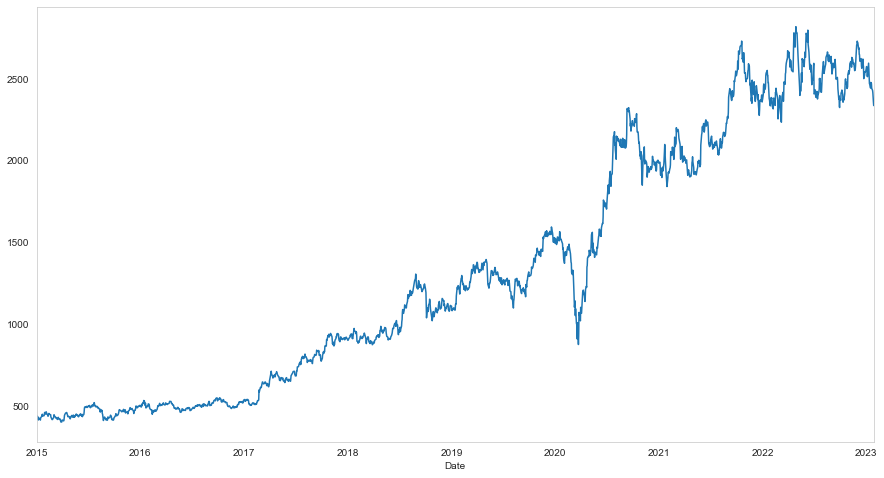

In [32]:
reliance_day['Close'].plot(figsize=(15,8))
stationarity(reliance_day['Close'])

Inference:

1) As you can see above, the Close column isn't stationarity.

Test Statistic: -34.741656885308515
P-Value: 0.0
Stationary


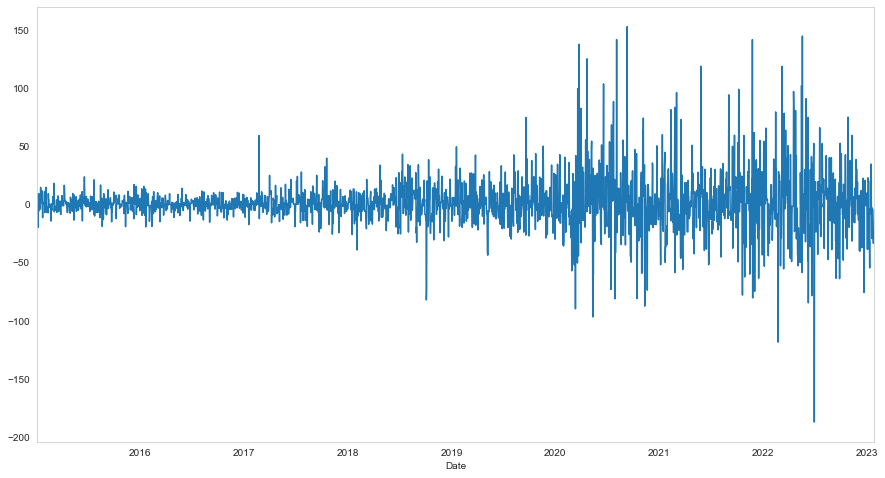

In [33]:
#Using differencing method to make data set stationary
diff_1_close = reliance_day['Close'].diff().dropna()
diff_1_close.plot(figsize=(15,8))

stationarity(diff_1_close)

Inference:
1) As you can see, after differencing once for Close column we get stationarity status. <br>So the d-value for our ARIMA model will equal to 1.

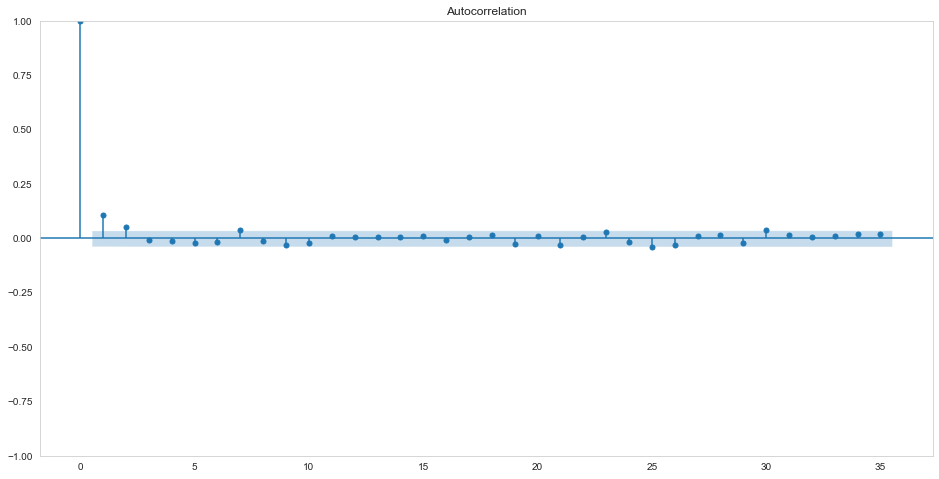

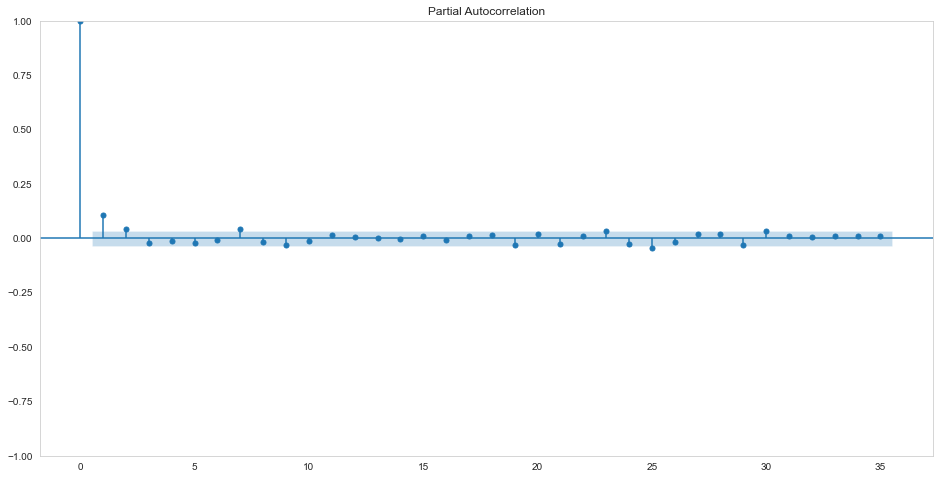

In [34]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

plot_acf(diff_1_close);
plot_pacf(diff_1_close);

Inference:

1) From ACF plot we can see that q values can be 1,2,7,25,30.<br>
2) From PACF plot we can see that p values can be 1,2,7,9,25.<br>

Grid Search p,d,q Values <br>
From acf and pacf we got different potential p,q values. Lets use grid search to find the best pair out of them

In [35]:
from sklearn.metrics import mean_squared_error
from math import sqrt

# evaluate an ARIMA model for a given order (p,d,q)
def evaluate_arima_model(arima_order):
    # prepare training dataset
    train_set, test_set= np.split(reliance_day, [int(.80 *len(reliance_day))])
    # make predictions
    model = ARIMA(train_set, order=arima_order).fit()
    pred_model = model.predict(start = test_set.index[0],end = test_set.index[-1])
    rmse = sqrt(mean_squared_error(test_set, pred_model))
    return rmse

In [36]:
# evaluate combinations of p, d and q values for an ARIMA model
def evaluate_models(dataset, p_values, q_values):
    dataset = dataset.astype('float32')
    best_score, best_cfg = float("inf"), None
    for p in p_values:
        for q in q_values:
                order = (p,1,q)
                try:
                    rmse = evaluate_arima_model(order)
                    if rmse < best_score:
                        best_score, best_cfg = rmse, order

                except:
                    continue
    print('Best ARIMA%s RMSE=%.3f' % (best_cfg, best_score))

In [37]:
# evaluate parameters
p_values = [1,2,7,25,30]
q_values = [1,2,7,9,25]

evaluate_models(reliance_day['Close'].values, p_values, q_values)

Best ARIMA(30, 1, 7) RMSE=288.093


In [38]:
# Building Arima using best parameters.
arima = ARIMA(train_set['Close'], order=(30,1,7)).fit()
pred_arima = arima.predict(start = test_set.index[0],end = test_set.index[-1])
MAPE_arima = mean_absolute_percentage_error(pred_arima,test_set.Close)
MAPE_arima

0.11597934124240322

## <h1><center><font color=darkblue>Long Term Forecasting</font><br></center></h1>

In [39]:
# Resampling day wise

downsampled_month = reliance2.resample('M').mean()
downsampled_month.head()

,Close
Date,
2015-01-31,434.100633
2015-02-28,441.272437
2015-03-31,422.823014
2015-04-30,435.631200
2015-05-31,439.321925


                 Close
Date                  
2015-01-31  434.100633
2015-02-28  441.272437
2015-03-31  422.823014
2015-04-30  435.631200
2015-05-31  439.321925
2015-06-30  464.820100
2015-07-31  500.829809
2015-08-31  460.440248
2015-09-30  423.801530
2015-10-31  455.351220


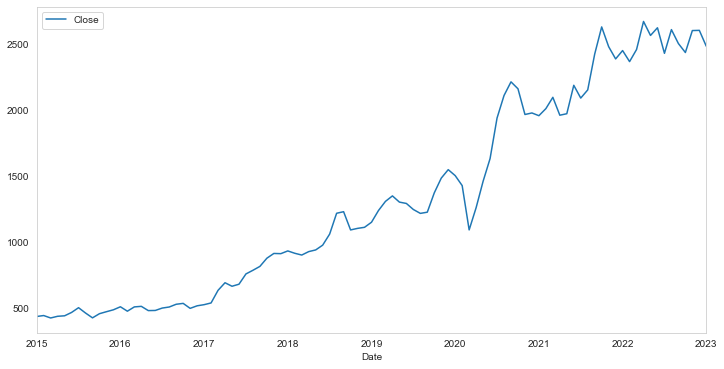

In [40]:
# Interpolation was done for nan values which we get after doing upsampling by Month

reliance_month = downsampled_month.interpolate(method='linear')
print(reliance_month.head(10))
reliance_month.plot(figsize=(12,6))
plt.show()

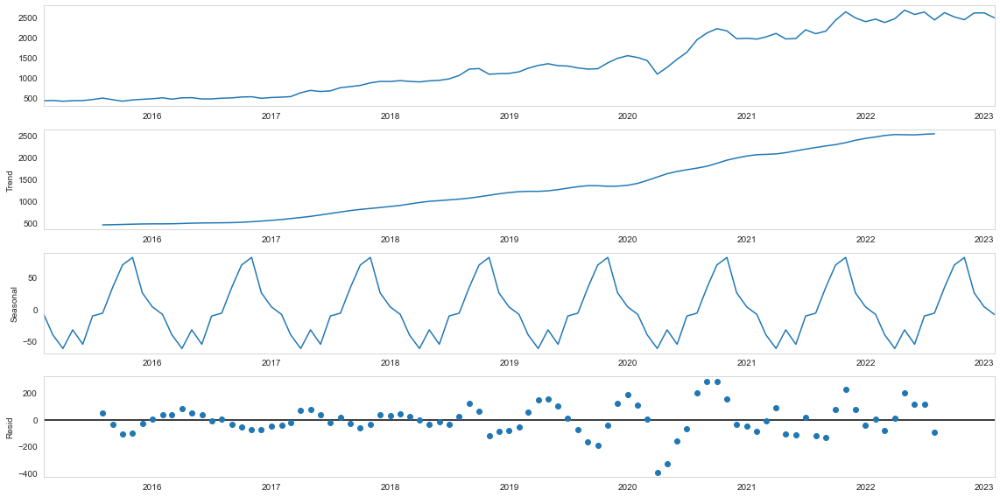

In [41]:
decompose_add = seasonal_decompose(reliance_month)
decompose_add.plot();

Inference:-<br>
1) Decomposition plot shows trend and seasonality.

In [42]:
# splitting data set in train, test (80% : 20%)
Train_set, Test_set= np.split(reliance_month, [int(.80 *len(reliance_month))])

### <font color=darkgreen>1. Single Exponential Smoothing</font><br>

Single Exponential Smoothing, SES for short, also called Simple Exponential Smoothing, is a time series forecasting method for univariate data without a trend or seasonality.

In [43]:
single_exp_l = SimpleExpSmoothing(Train_set["Close"]).fit()
pred_single_exp_l = single_exp_l.predict(start = Test_set.index[0],end = Test_set.index[-1])
MAPE_single_exp_l = mean_absolute_percentage_error(pred_single_exp_l,Test_set.Close)
MAPE_single_exp_l

0.24657664826597783

### <font color=darkgreen> 2.Double Exponential Smoothing</font><br>

Double Exponential Smoothing is an extension to Exponential Smoothing that explicitly adds support for trends in the univariate time series

In [44]:
double_exp_l = ExponentialSmoothing(Train_set["Close"], trend=None, seasonal='add').fit()
pred_double_exp_l = double_exp_l.predict(start = Test_set.index[0],end = Test_set.index[-1])
MAPE_double_exp_l = mean_absolute_percentage_error(pred_double_exp_l,Test_set.Close)
MAPE_double_exp_l

0.22861296752108973

### <font color=darkgreen>3.Triple Exponential Smoothing</font><br>

Triple Exponential Smoothing is an extension of Exponential Smoothing that explicitly adds support for seasonality to the univariate time series. Also known as Holt-Winters Exponential Smoothing.

In [45]:
triple_exp_l = ExponentialSmoothing(Train_set["Close"], trend = 'add', seasonal = "add", seasonal_periods=12).fit()
pred_triple_exp_l = triple_exp_l.predict(start = Test_set.index[0],end = Test_set.index[-1])
MAPE_triple_exp_l = mean_absolute_percentage_error(pred_triple_exp_l,Test_set.Close)
MAPE_triple_exp_l

0.09341190879110486

### <font color=darkgreen>4. ARIMA</font><br>

NOTE:-<br>
Checking Whether Time-Series is Stationary or Not.<br>
Dicky-Fuller Test for Stationarity.(Once we have removed trend and seasonality from time-series data then we can test its stationarity using a dicky-fuller test. It's a statistical test to check the stationarity of time-series data.)

In [46]:
import matplotlib.pyplot as plt
from statsmodels.tsa.stattools import adfuller

def stationarity(col):
    res = adfuller(col.dropna())
    print("Test Statistic:", res[0])
    print("P-Value:", res[1])
    if res[1] < 0.05:
        print("Stationary")
    else:
        print("Non-Stationary")

Test Statistic: 0.7860192814913622
P-Value: 0.9914071082294027
Non-Stationary


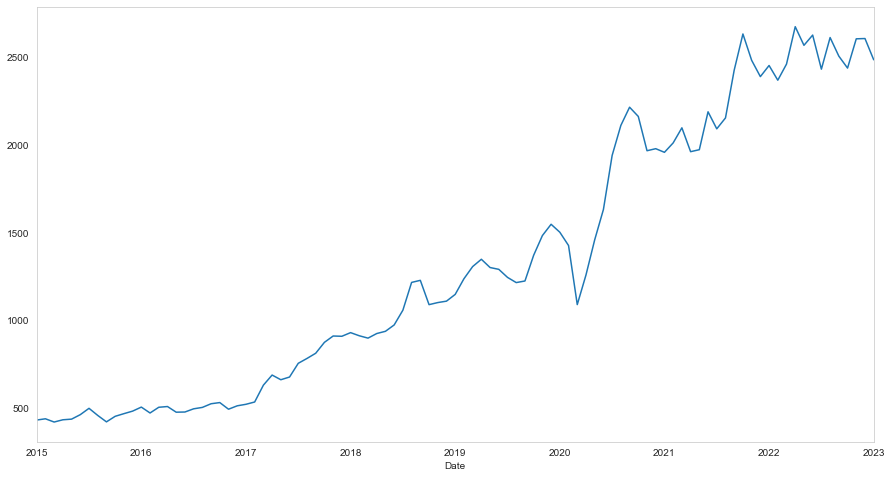

In [47]:
reliance_month['Close'].plot(figsize=(15,8))
stationarity(reliance_month['Close'])

Inference:

1) As you can see above, the Close column isn't stationarity.

Test Statistic: -3.8896415904669372
P-Value: 0.0021124157068186586
Stationary


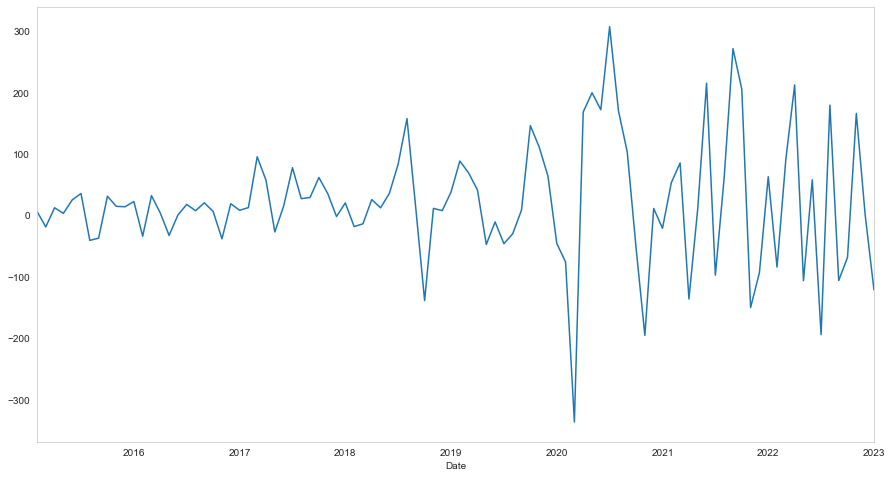

In [48]:
# Using differencing method to make data set stationary
diff_1_close_l = reliance_month['Close'].diff().dropna()
diff_1_close_l.plot(figsize=(15,8))

stationarity(diff_1_close_l)

Inference:
1) As you can see, after differencing once for Close column we get stationarity status. <br>So the d-value for our ARIMA model will equal to 1.

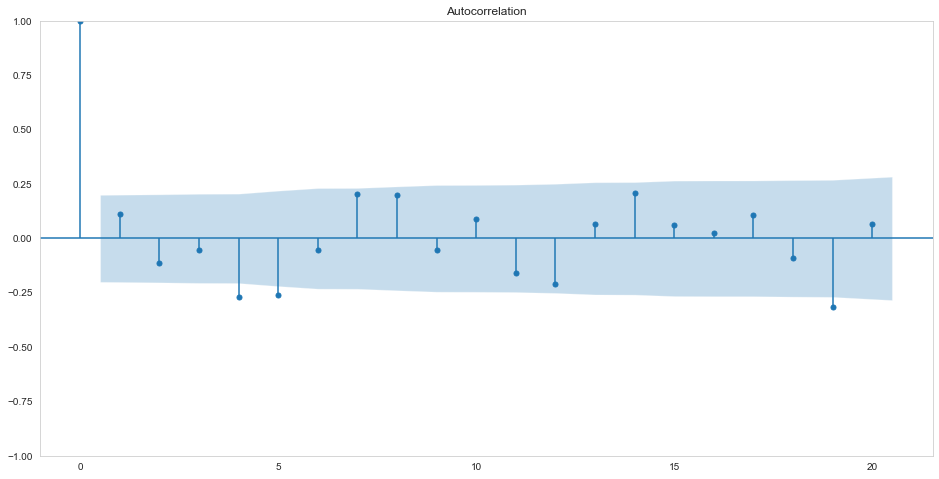

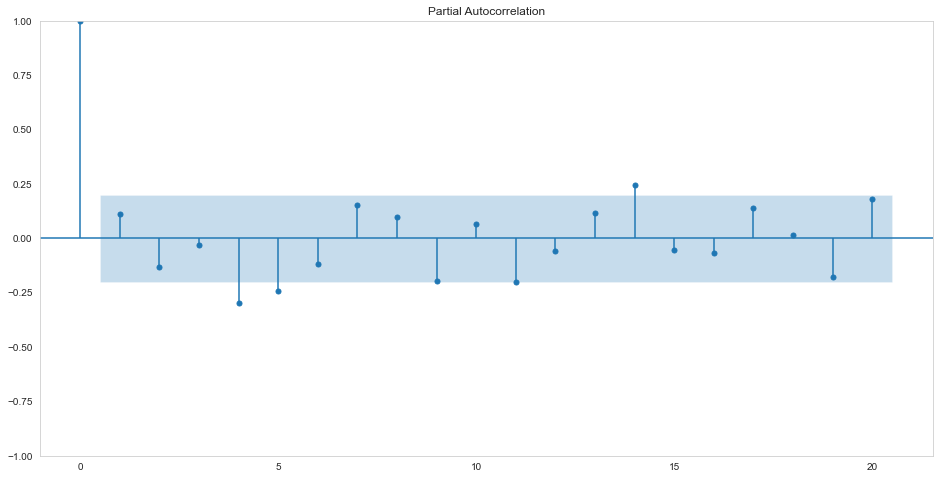

In [49]:
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf

plot_acf(diff_1_close_l);
plot_pacf(diff_1_close_l);

Inference:

1) From ACF plot we can see that q values can be 4,5,19.<br>
2) From PACF plot we can see that p values can be 4,5,14,20.<br>

Grid Search p,d,q Values <br>
From acf and pacf we got different potenstial p,q values. Lets use grid search to find the best pair out of them

In [50]:
from sklearn.metrics import mean_squared_error
from math import sqrt

# evaluate an ARIMA model for a given order (p,d,q)
def evaluate_arima_model(arima_order):
    # prepare training dataset
    Train_set, Test_set= np.split(reliance_month, [int(.80 *len(reliance_month))])
    # make predictions
    model = ARIMA(Train_set, order=arima_order).fit()
    pred_model = model.predict(start = Test_set.index[0],end = Test_set.index[-1])
    rmse = sqrt(mean_squared_error(Test_set, pred_model))
    return rmse

In [51]:
# evaluate combinations of p, d and q values for an ARIMA model
def evaluate_models(dataset, p_values, q_values):
    dataset = dataset.astype('float32')
    best_score, best_cfg = float("inf"), None
    for p in p_values:
        for q in q_values:
                order = (p,1,q)
                try:
                    rmse = evaluate_arima_model(order)
                    if rmse < best_score:
                        best_score, best_cfg = rmse, order

                except:
                    continue
    print('Best ARIMA%s RMSE=%.3f' % (best_cfg, best_score))

In [52]:
# evaluate parameters
p_values = [4,5,19]
q_values = [4,5,14,20]

evaluate_models(reliance_month['Close'].values, p_values, q_values)

Best ARIMA(19, 1, 5) RMSE=236.143


In [53]:
# Building Arima using best parameters.
arima_l = ARIMA(Train_set['Close'], order=(19,1,5)).fit()
pred_arima_l = arima_l.predict(start = Test_set.index[0],end = Test_set.index[-1])
MAPE_arima_l = mean_absolute_percentage_error(pred_arima_l,Test_set.Close)
MAPE_arima_l

0.09102252609393016

### <font color=darkgreen>Comparing the Results</font><br>

In [54]:
data = {"MODEL":pd.Series(["Single Exponential Smoothing","Double Exponential Smoothing","Triple Exponential Smoothing","ARIMA_Model"]),
        "MAPE_Values_Day":pd.Series([MAPE_single_exp,MAPE_double_exp,MAPE_triple_exp,MAPE_arima]),
       "MAPE_Values_Month":pd.Series([MAPE_single_exp_l,MAPE_double_exp_l,MAPE_triple_exp_l,MAPE_arima_l])
       } 
table_MAPE = pd.DataFrame(data)
table_MAPE

# Defining custom function 
# which returns the list for
# df.style.apply() method
def highlight_min(s):
    if s.dtype == np.object:
        is_min = [False for _ in range(s.shape[0])]
    else:
        is_min = s == s.min()
          
    return ['background: lightgreen' if cell else '' 
            for cell in is_min]
  
table_MAPE.style.apply(highlight_min)

,MODEL,MAPE_Values_Day,MAPE_Values_Month
0,Single Exponential Smoothing,0.124139,0.246577
1,Double Exponential Smoothing,0.124591,0.228613
2,Triple Exponential Smoothing,0.055564,0.093412
3,ARIMA_Model,0.115979,0.091023


Inference:
<br>
1) Highlighted cells show the ideal MAPE values for respective time frames.<br>
2) Triple exponential smoothing model gives lowest MAPE value for daily time frame.<br>
3) ARIMA model gives lowest MAPE value for monthly time frame.

## <h1><center><font color=darkblue>Final Models by Combining Train and Test</font><br>

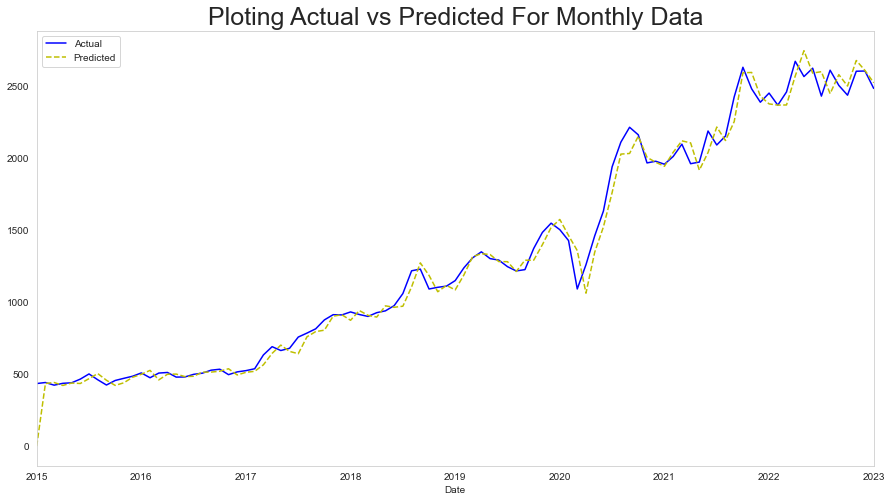

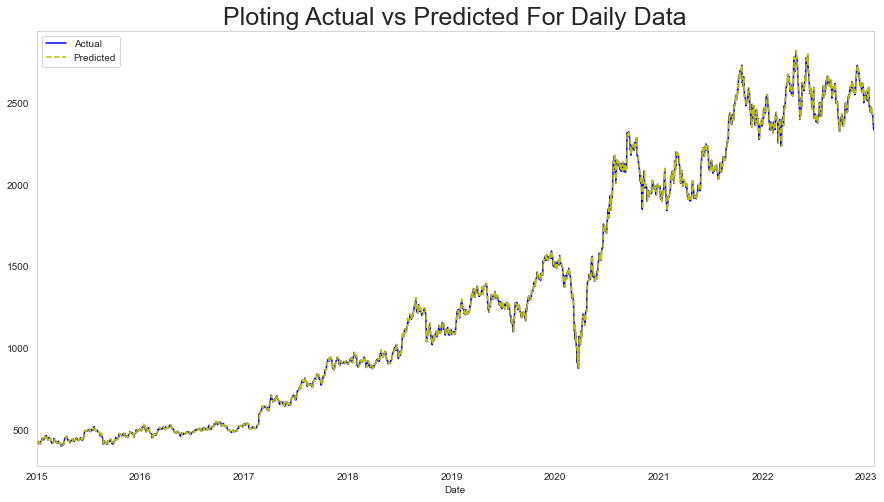

In [55]:
# Building Final Model And Ploting Actual vs Predicted For Month.
arima_l = ARIMA(reliance_month['Close'], order=(19,1,5)).fit()
pred_arima_l = arima_l.predict(start = reliance_month.index[0],end = reliance_month.index[-1])

reliance_month['Close'].plot(color='b',legend=True,label='Actual',figsize=(15,8))
pred_arima_l.plot(style='--',color='y',legend=True,label='Predicted')
plt.title("Ploting Actual vs Predicted For Monthly Data",fontsize = 25)
plt.show()

# Building Final Model And Ploting Actual vs Predicted For Daily Data
triple_exp = ExponentialSmoothing(reliance_day["Close"], trend = 'add', seasonal = "add", seasonal_periods=10).fit()
pred_triple_exp = triple_exp.predict(start = reliance_day.index[0],end = reliance_day.index[-1])

reliance_day["Close"].plot(color='b',legend=True,label='Actual',figsize=(15,8))
pred_triple_exp.plot(style='--',color='y',legend=True,label='Predicted')
plt.title("Ploting Actual vs Predicted For Daily Data",fontsize = 25)
plt.show()

Inference:

<br>
Above plot shows predicted vs actual values for respective time frame.


In [56]:
# Forecasting for next 24 month
arima_l_cast = arima_l.forecast(24)
arima_l_cast

2023-02-28    2649.057893
2023-03-31    2567.838805
2023-04-30    2557.492290
2023-05-31    2598.934224
2023-06-30    2710.201068
2023-07-31    2674.769132
2023-08-31    2667.518474
2023-09-30    2736.031904
2023-10-31    2741.000611
2023-11-30    2623.931064
2023-12-31    2748.505788
2024-01-31    2732.133344
2024-02-29    2776.208602
2024-03-31    2737.280698
2024-04-30    2835.912707
2024-05-31    2840.257558
2024-06-30    2743.102239
2024-07-31    2848.122083
2024-08-31    2903.732560
2024-09-30    2773.245635
2024-10-31    2924.378369
2024-11-30    2918.110736
2024-12-31    2890.994784
2025-01-31    2894.591840
Freq: M, Name: predicted_mean, dtype: float64

In [57]:
# Forecasting for next 30 days
triple_exp = triple_exp.forecast(30)
triple_exp

2023-01-28    2338.625155
2023-01-29    2336.826680
2023-01-30    2333.619178
2023-01-31    2335.936915
2023-02-01    2335.459441
2023-02-02    2337.364552
2023-02-03    2336.075211
2023-02-04    2341.341786
2023-02-05    2341.662750
2023-02-06    2338.581730
2023-02-07    2339.709672
2023-02-08    2337.911197
2023-02-09    2334.703695
2023-02-10    2337.021432
2023-02-11    2336.543958
2023-02-12    2338.449069
2023-02-13    2337.159728
2023-02-14    2342.426303
2023-02-15    2342.747266
2023-02-16    2339.666246
2023-02-17    2340.794188
2023-02-18    2338.995713
2023-02-19    2335.788211
2023-02-20    2338.105949
2023-02-21    2337.628475
2023-02-22    2339.533585
2023-02-23    2338.244244
2023-02-24    2343.510819
2023-02-25    2343.831783
2023-02-26    2340.750763
Freq: D, dtype: float64

## <h1><center><font color=darkblue>Model Deployment</font><br></center></h1>

### Deploying Model by Streamlit.